# Compare Models

DS 5001 Text as Data

# Set Up

## Config

In [1]:
import configparser
config = configparser.ConfigParser()
config.read("../../../env.ini")
data_home = config['DEFAULT']['data_home']
output_dir = config['DEFAULT']['output_dir']
local_lib = config['DEFAULT']['local_lib']

In [2]:
data_prefix = "winereviews"

## Import

In [3]:
import pandas as pd
import numpy as np
import plotly_express as px

# Results

In [4]:
models = 'NB SKMNB MI PERCEPTRON SVM LOGREG'.split()
results = {model: pd.read_csv(f'{data_home}/{data_prefix}/{data_prefix}-{model}_RESULT.csv').set_index('model_id') for model in models}
RESULT = pd.concat([results[model] for model in models], axis=0)

In [5]:
RESULT

,TN,FN,TP,FP,T,F,ALL,ACC,TPR,TNR,PPV,BA,F1
model_id,,,,,,,,,,,,,
nb,3084,694,3277,945,6361,1639,8000,0.795125,0.825233,0.765450,0.776172,0.795342,0.799951
skmnb,3252,877,3152,719,6404,1596,8000,0.800500,0.782328,0.818937,0.814260,0.800633,0.797975
mi,1928,598,3373,2101,5301,2699,8000,0.662625,0.849408,0.478531,0.616186,0.663969,0.714240
perceptron,3434,1194,2777,595,6211,1789,8000,0.776375,0.699320,0.852321,0.823547,0.775820,0.756367
svm,3290,839,3132,739,6422,1578,8000,0.802750,0.788718,0.816580,0.809093,0.802649,0.798776
logreg,3367,720,3251,662,6618,1382,8000,0.827250,0.818685,0.835691,0.830820,0.827188,0.824708


In [6]:
RESULT1 = RESULT.iloc[:, :7]

In [7]:
RESULT1.style.background_gradient(cmap='YlGnBu') # COUNTS

,TN,FN,TP,FP,T,F,ALL
model_id,,,,,,,
nb,3084,694,3277,945,6361,1639,8000
skmnb,3252,877,3152,719,6404,1596,8000
mi,1928,598,3373,2101,5301,2699,8000
perceptron,3434,1194,2777,595,6211,1789,8000
svm,3290,839,3132,739,6422,1578,8000
logreg,3367,720,3251,662,6618,1382,8000


In [8]:
RESULT2 = RESULT.iloc[:,7:] # RATIOS

In [9]:
ratio_names = {
    'ACC':'accuracy',
    'TPR': 'recall',
    'TNR': 'specificity',
    'PPV': 'precision',
    'BA': 'balacc',
    'F1': 'F1'
}

In [10]:
RESULT2.columns = [ratio_names[col] for col in RESULT2.columns]

In [11]:
RESULT2.sort_values('F1', ascending=False).style.format(precision=2).background_gradient(cmap='YlGnBu', axis=0)

,accuracy,recall,specificity,precision,balacc,F1
model_id,,,,,,
logreg,0.83,0.82,0.84,0.83,0.83,0.82
nb,0.80,0.83,0.77,0.78,0.80,0.80
svm,0.80,0.79,0.82,0.81,0.80,0.80
skmnb,0.80,0.78,0.82,0.81,0.80,0.80
perceptron,0.78,0.70,0.85,0.82,0.78,0.76
mi,0.66,0.85,0.48,0.62,0.66,0.71


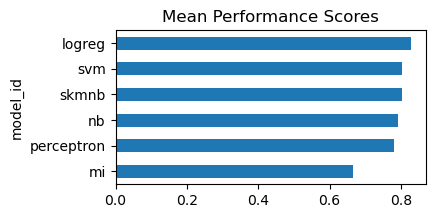

In [12]:
RESULT2.T.mean().sort_values().plot.barh(figsize=(4,2), title="Mean Performance Scores");

In [13]:
METRIC = pd.concat([RESULT2.idxmax(), RESULT2.max(), RESULT2.idxmin(), RESULT2.min()], axis=1, 
                   keys=['argmax','max','argmin','min'])

In [14]:
METRIC.style.format(precision=2)

,argmax,max,argmin,min
accuracy,logreg,0.83,mi,0.66
recall,mi,0.85,perceptron,0.70
specificity,perceptron,0.85,mi,0.48
precision,logreg,0.83,mi,0.62
balacc,logreg,0.83,mi,0.66
F1,logreg,0.82,mi,0.71


**Winners**

In [15]:
METRIC.argmax.value_counts()

argmax
logreg        4
mi            1
perceptron    1
Name: count, dtype: int64

**Losers**

In [16]:
METRIC.argmin.value_counts()

argmin
mi            5
perceptron    1
Name: count, dtype: int64

# SALEXes

In [17]:
salex_cols = ['valence', 'polarity', 'normalized']

In [18]:
salexes = {model : pd.read_csv(f'{data_home}/{data_prefix}/{data_prefix}-{model}_SALEX.csv').set_index('term_str')
         for model in models}

In [19]:
SALEX = pd.concat([salexes[model][salex_cols] for model in models], keys=models, axis=1)

In [21]:
NORM = SALEX.swaplevel(axis=1).normalized.dropna()

In [23]:
VOCAB = pd.read_csv(f'{data_home}/{data_prefix}/{data_prefix}-VOCAB.csv').set_index('term_str')

In [24]:
VOCAB

,n,f,stem,sw,go
term_str,,,,,
aaron,4,0.000005,aaron,False,True
abandon,3,0.000004,abandon,False,True
abbey,3,0.000004,abbey,False,True
abbreviated,4,0.000005,abbrevi,False,True
ability,25,0.000033,abil,False,True
...,...,...,...,...,...
zippy,28,0.000036,zippi,False,True
zone,3,0.000004,zone,False,True
zweigelt,6,0.000008,zweigelt,False,True


# Compare Models 

Note differences between generative and discriminant models.

In [25]:
px.scatter_matrix(NORM, height=1000, width=1000)

In [26]:
CORR = NORM.corr().stack().to_frame('r')
CORR.index.names = ['model_1', 'model_2']
CORR = CORR.query("model_1 < model_2")

In [27]:
CORR.sort_values('r', ascending=False).style.format(precision=2).background_gradient(cmap="YlGnBu")

# Means of Normalized Valence

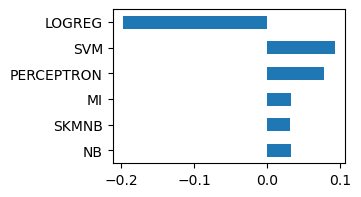

In [28]:
NORM.mean().plot.barh(figsize=(3,2));

# Mean Normalized Valence

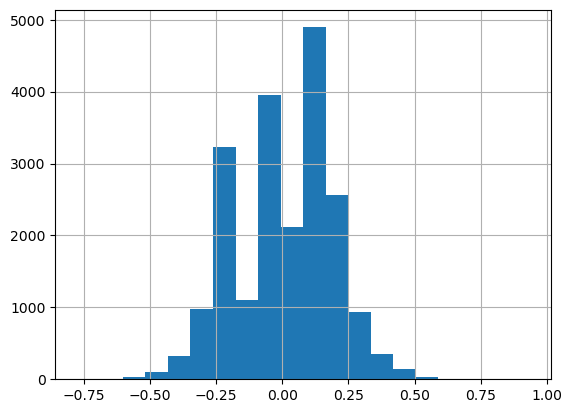

In [29]:
MEAN = NORM.T.mean()
MEAN.hist(bins=20);

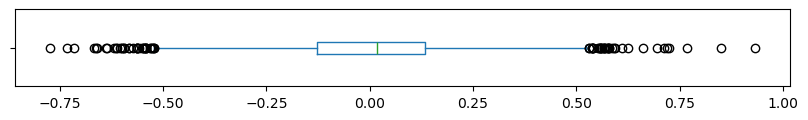

In [30]:
MEAN.plot.box(vert=False, figsize=(10, 1));

In [31]:
pd.concat([MEAN.sort_values(ascending=False).head(20).reset_index().rename(columns={0:'norm_valence'}), 
           MEAN.sort_values(ascending=False).tail(20).sort_values().reset_index().rename(columns={0:'norm_valence'})],
          axis=1, keys=['high', 'low'])

high                      low             
      term_str norm_valence    term_str norm_valence
0           92     0.931894    everyday    -0.773795
1         2027     0.851118       raspy    -0.732786
2       coiled     0.767904      dilute    -0.716565
3         2030     0.724256       murky    -0.666557
4    exquisite     0.720247    detracts    -0.663621
5           91     0.711982  disjointed    -0.660846
6      editors     0.695307       weedy    -0.637693
7           94     0.660450        fuss    -0.634916
8     hedonism     0.626152      watery    -0.619290
9         2024     0.610685       pizza    -0.615071
10     lovable     0.594389    counties    -0.612457
11        2031     0.592481    granular    -0.604516
12   unabashed     0.586266    aperitif    -0.600692
13     echoing     0.579249      quadra    -0.598772
14       2020s     0.579175   torrontés    -0.594836
15   thrilling     0.577328     unfussy    -0.594142
16       humus     0.576298       timid    -0.583756
17   endlessly     0.574075     diluted    -0.581780
18  benefiting     0.569876     discern    -0.573571
19         sly     0.567900      barsac    -0.563580

# Scatter plots of term frequency

In [32]:
X = NORM.join(VOCAB)
X['mean'] = MEAN

In [47]:
X['PERCEPTRON'].sort_values()

term_str
quadra       -1.000000
guarantees   -0.863248
bedell       -0.811966
dardis       -0.743590
forewarned   -0.743590
                ...   
garnachas     0.931624
humus         0.948718
coiled        0.948718
plodding      1.000000
dollarhide    1.000000
Name: PERCEPTRON, Length: 20772, dtype: float64

In [34]:
def text(x):
    fig = px.scatter(X.reset_index(), x, 'n', text='term_str', height=800, width=900, title=x)
    fig.update_traces(mode="text")
    fig.show()

## Naive Bayes

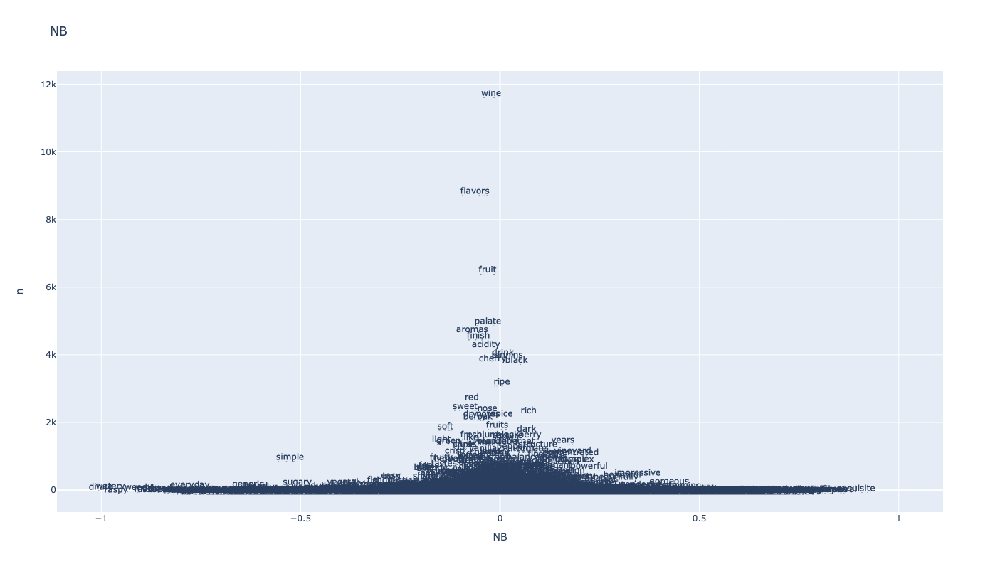

In [35]:
text('NB')

## SK Naive Bayes

In [36]:
text('SKMNB')

## Perceptron

In [37]:
text('PERCEPTRON')

## EMI

In [38]:
text('MI')

## SVM

In [39]:
text('SVM')

## LOGREG

In [40]:
text('LOGREG')

## Mean

In [41]:
text('mean')

# Observations

- Logistic Regression is the best performer by F1, mean peformance score, performance score wins.
  - Home-grown Naive Bayes is a close second.
  - All perform in the same range excpet Expected Mutual Information (MI).
  - MI is the least balanced with high recall but low specificity and precision.
- The discriminant models are highly correlated to each other, as are the generative ones.
  - The discriminant models are lowly correlated with the generative ones.
  - The two classes of methods seem to produce in-group similar results.
- The generative models appear to produce more intelligible vocabularies.
  - The discriminant models produce some curious negative terms, e.g. 'stonecap', 'venerable', 'distinguish'

# Save

In [42]:
SALEX.columns.names = ['model_id', 'metric']

In [43]:
SALEX.T.to_csv(f"{data_home}/{data_prefix}/{data_prefix}-ALL_SALEX.csv", index=True)

In [44]:
RESULT.to_csv(f"{data_home}/{data_prefix}/{data_prefix}-ALL_RESULT.csv", index=True)